In [62]:
import json

import pandas as pd
import tensorflow
import matplotlib.pyplot as plt
import numpy as np
import keras
import neurokit2 as nk
import tensorflow as tf

from tensorflow.keras import layers, losses
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Model
from keras.regularizers import l2

# Read data from CSV files

In [2]:
def read_csv(filepath):
    f = open(filepath)
    data = json.load(f)
    return data

#ecg = read_csv('Preprocessed_data/ecg/ecg_unfiltered.txt')
ecg_filt = read_csv('Preprocessed_data/ecg/ecg_filtered.txt')

# Remove first and last few minutes of data for cleaning and split it into segments of 10 seconds

In [3]:
#remove first and last few minutes
for patient in ecg_filt:
    ecg_filt[patient] = ecg_filt[patient][5000:700000]
    #ecg[patient] = ecg[patient][5000:763000]

    ecg_filt[patient] = nk.ecg_clean(ecg_filt[patient], sampling_rate=62.475)

In [4]:
duration = int(20*62.4725)
segments_ecg = []

for patient in ecg_filt:
    values = ecg_filt[patient]
    for i in range(0,len(values) - duration + 1, duration):
        segments_ecg.append(values[i : (i + duration)])

# Find quality of each segment
 Assess the quality of the ECG Signal by extracting several signal quality indexes (SQIs): QRS wave power spectrum distribution pSQI, kurtosis kSQI, and baseline relative power basSQI.  It returns a vector containing the quality index classification (Unacceptable, Barely Acceptable or Excellent) of the signal.
 We remove the Invalid signals from our datatset for training the autoencoder

In [5]:
quality = []
for i in range(len(segments_ecg)):
    try:
        quality.append(nk.ecg_quality(segments_ecg[i],
                   sampling_rate = 62.475,
                   method="zhao2018",
                   approach="simple"))
    except:
        quality.append("Invalid Input")

In [6]:
indices = np.where(np.array(quality) != "Invalid Input")[0]

normal_ecg = [segments_ecg[x] for x in indices]


# Split the data into Train test and validation sets
- Train set: 60%
- Test set: 20%
- Validation set: 20%

In [129]:
train_df, test_df = train_test_split(normal_ecg,test_size=0.4,shuffle = True)

train_df = np.stack(train_df)
test_df = np.stack(test_df)

x_train = [ [0] for i in range(len(train_df))]
x_test = [ [0] for i in range(len(test_df))]

def create_epochs(signal, output):
    for i in range(len(signal)):
        temp = signal[i]
        output[i] = [temp[i:i + int(1*62.475)] for i in range(0, len(temp), int(1*62.475))]
        del output[i][-1]
    return np.array(output)

x_train = create_epochs(train_df, x_train)
x_test = create_epochs(test_df, x_test)

print("Training input shape: ", x_train.shape)
print("Test input shape: ", x_test.shape)

Training input shape:  (5533, 20, 62)
Test input shape:  (3690, 20, 62)


# Define the Autoencoder model

In [153]:
class detector(Model):
    def __init__(self):
        super(detector, self).__init__()
        self.encoder = tf.keras.Sequential([
            layers.Input(shape=(x_train.shape[1], x_train.shape[2])),
            layers.Conv1D(filters=32, kernel_size=5, padding="same", strides=1, activation="relu", kernel_regularizer=l2(0.02)),
            layers.Conv1D(filters=16, kernel_size=5, padding="same", strides=1, activation="relu",kernel_regularizer=l2(0.02)),
            layers.Conv1D(filters=8, kernel_size=5, padding="same", strides=1, activation="relu",kernel_regularizer=l2(0.01))
        ])
        self.decoder = tf.keras.Sequential([
            layers.Conv1D(filters=8, kernel_size=5, padding="same", strides=1, activation="relu",kernel_regularizer=l2(0.02)),
            layers.Conv1D(filters=16, kernel_size=5, padding="same", strides=1, activation="relu", kernel_regularizer=l2(0.01)),
            layers.Conv1D(filters=1, kernel_size=5, padding="same")
        ])

    def call(self, x):
        encoded = self.encoder(x)
        decoded = self.decoder(encoded)
        return decoded

    def encoding(self, x):
        encoded = self.encoder(x)
        #decoded = self.decoder(encoded)
        return encoded

In [154]:
#Let's compile and train the model!!
autoencoder = detector()
autoencoder.compile(optimizer="adam", loss="mse")

# Train the model

In [155]:
history = autoencoder.fit(
    x_train,
    x_train,
    epochs=10,
    batch_size=128,
    callbacks=[
        keras.callbacks.EarlyStopping(monitor="loss", patience=2, mode="min")
    ],
)

Epoch 1/10
44/44 [==============================] - 2s 16ms/step - loss: 1.1344
Epoch 2/10
44/44 [==============================] - 1s 14ms/step - loss: 0.4519
Epoch 3/10
44/44 [==============================] - 1s 13ms/step - loss: 0.2111
Epoch 4/10
44/44 [==============================] - 1s 18ms/step - loss: 0.1259
Epoch 5/10
44/44 [==============================] - 1s 20ms/step - loss: 0.0931
Epoch 6/10
44/44 [==============================] - 1s 17ms/step - loss: 0.0793
Epoch 7/10
44/44 [==============================] - 1s 16ms/step - loss: 0.0732
Epoch 8/10
44/44 [==============================] - 1s 16ms/step - loss: 0.0705
Epoch 9/10
44/44 [==============================] - 1s 17ms/step - loss: 0.0692
Epoch 10/10
44/44 [==============================] - 1s 17ms/step - loss: 0.0687


# Get Latent space

In [156]:
latent_space = detector.encoding(autoencoder, x_test)

# Use the latent space for clustering

#### The dimensions of the input samples have been reduced from 62 to 4 via the encoding layers of the autoencoder. This reduced feature space is used as the features for clustering

In [163]:
from sklearn.cluster import DBSCAN


def find_anomalies_using_DBSCAN(latent_space):
    features_only = pd.DataFrame(latent_space)
    clustering = DBSCAN(eps=0.0001, min_samples=5).fit(features_only)
    DBSCAN_dataset = features_only.copy()
    DBSCAN_dataset.loc[:,'Cluster'] = clustering.labels_

    clusters = DBSCAN_dataset.Cluster.value_counts().to_frame()
    y_pred = clustering.fit_predict(features_only)

    anomoly_indices = np.where(y_pred == -1)[0]
    return clusters, anomoly_indices

In [164]:
clusters = []
anomaly_indices = []
for i in range(len(latent_space)):
    c, a = find_anomalies_using_DBSCAN(latent_space[i])
    clusters.append(c)
    anomaly_indices.append(a)

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_1980\995209824.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


KeyboardInterrupt: 

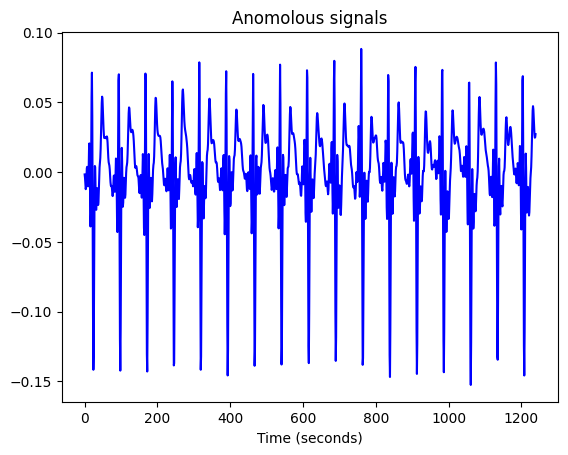

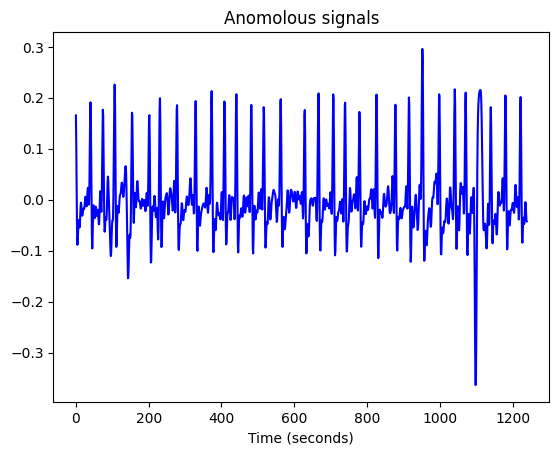

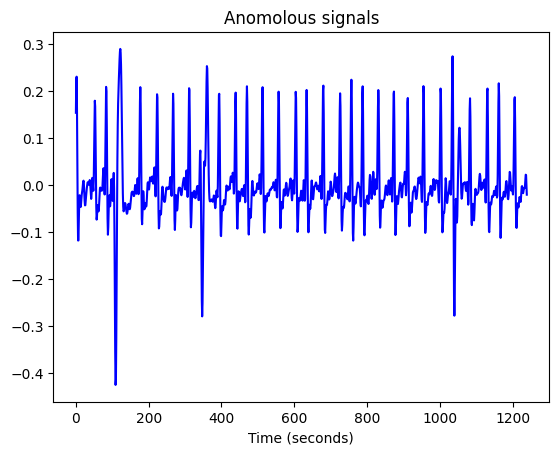

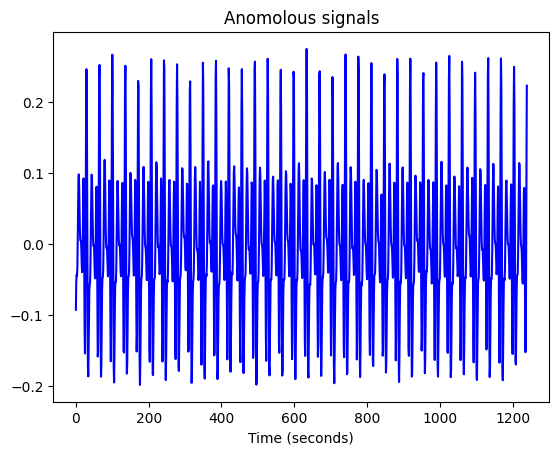

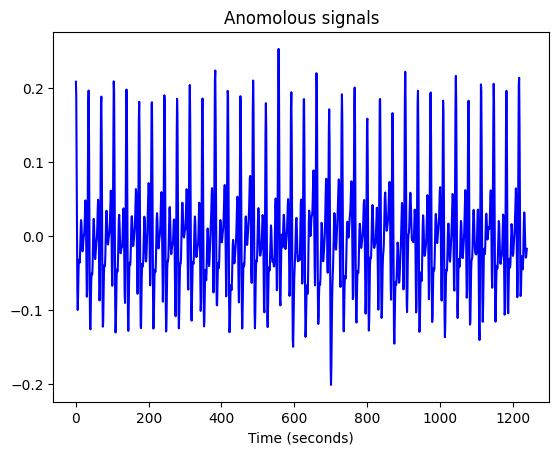

...

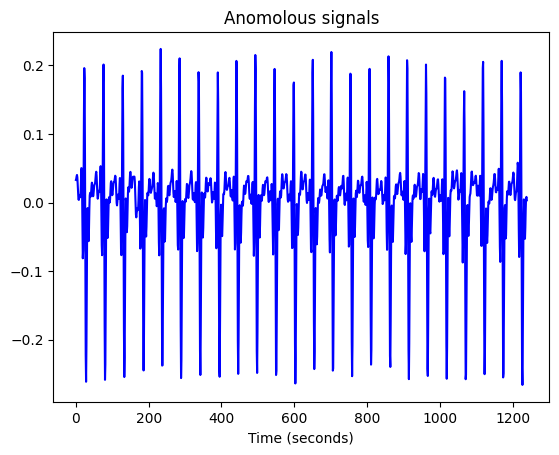

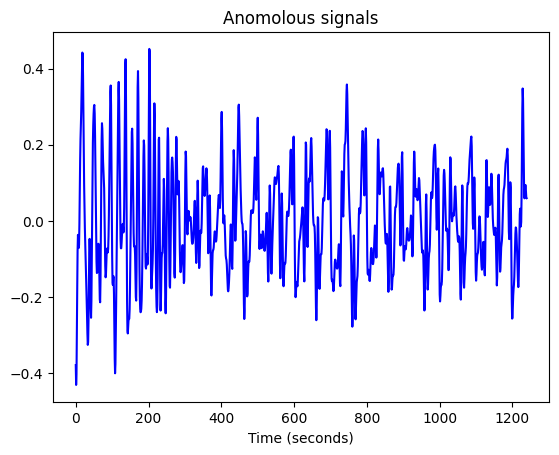

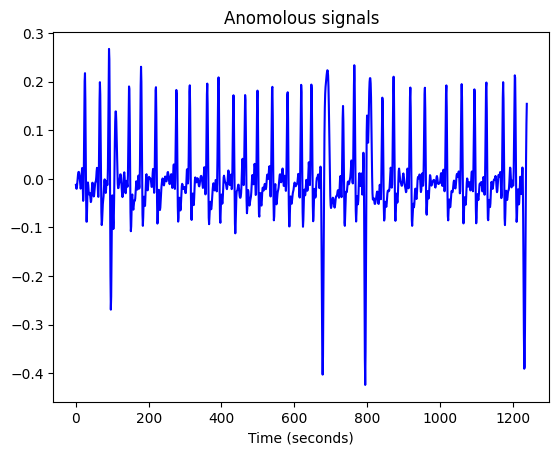

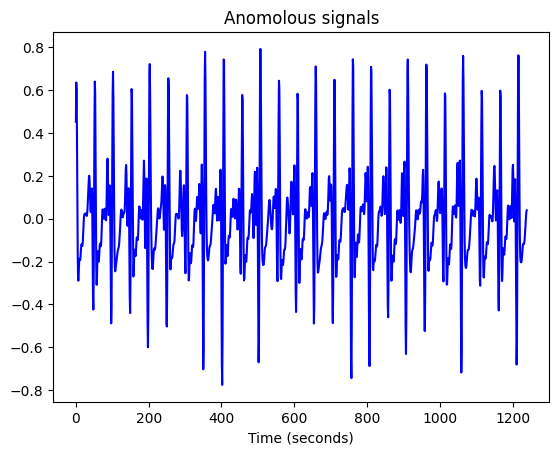

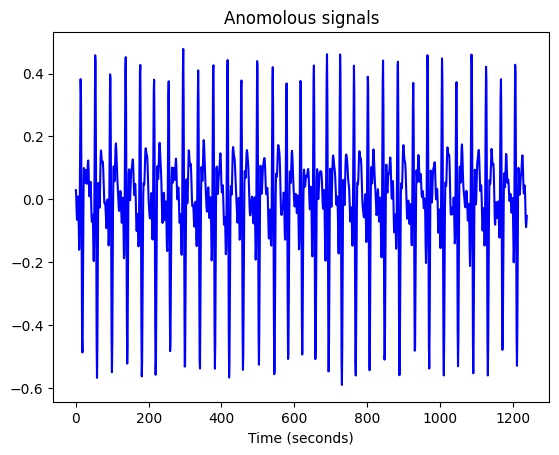

In [ ]:
#anomolous_signals = np.take(features_only, anomoly_indices, 0)

for i in range(len(x_test)):
    fig, ax = plt.subplots()

    ax.set_title("Anomolous signals")
    ax.set_xlabel("Time (seconds)")
    t = np.arange(0,int(20*62))

    ax.plot(t,x_test[i].flatten(), color = "blue")
    if len(anomaly_indices[i]) >0:
        for j in range(len(anomaly_indices[i])):
            start = anomaly_indices[i][j]*62
            ax.plot(t[start:start+62],x_test[i].flatten()[start:start+62], color = "red")
            #plt.savefig('anomalies_clustering/'+str(num)+'.png')